In [2]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
import numpy as np

# Path hack.
import sys, os
from os.path import join, basename, dirname, exists
sys.path.insert(0, os.path.abspath('..'))
from scripts.data_utils.generators import SeismicGenerator, SequencePathGenerator
from scripts.data_utils.grid_utils import blockshaped, unblockshaped, plot_embeddings
from cpc.benchmark_model_seismic import encode, load_encoder

# declare parent dir name 
dirname = sys.path[0] # parent directory

"""
Representation Learning with Contrastive Predictive Coding
The goal of unsupervised representation learning is to capture semantic information about the world,
recognizing patterns in the data without using annotations. 
This paper presents a new method called Contrastive Predictive Coding (CPC) that can do so across multiple applications. 
The main ideas of the paper are:
* Contrastive: it is trained using a contrastive approach, that is,
  the main model has to discern between *right* and *wrong* data sequences.
* Predictive: the model has to predict future patterns given the current context.
* Coding: the model performs this prediction in a latent space, transforming code vectors 
  into other code vectors (in contrast with predicting high-dimensional data directly).

CPC has to predict the next item in a sequence using only an embedded representation of the data, 
xrovided by an encoder. In order to solve the task, this encoder has to learn a meaningful representation 
of the data space. After training, this encoder can be used for other downstream tasks like supervised classification.




The cpc article descibes the following pattern:

Pre-processing:
-(own) from a random iline/xline/tline > 256*256 we extract pathces of 256x256 using sklearn image.extract_patches_2d
-from a 256x256 image we extract a 7x7 grid of 64x64 crops
with 32 pixels overlap. 

-(TODO)Simple data augmentation proved helpful on both the 256x256 images and the
64x64 crops. 
-(DONE)The 256x256 images are randomly cropped from a 300x300 image
- horizontally flipped with a probability of 50% and converted to greyscale. 
-For each of the 64x64 crops we randomly take
a 60x60 subcrop and pad them back to a 64x64 image.
-MNIST example uses RGB channels. Seimsic is grayscale. Would it help to pick and generate x attributes as channels
Encoder:
-(DONE)Each crop is then encoded by the ResNet-v2-101 encoder
- (DONE)We use the outputs from the third residual
block, and spatially mean-pool to get a single 1024-d vector per 64x64 patch. This results in a
7x7x1024 tensor.
"""

# change the patch_size and stride to get different girds. if stride is less than patch_size--> we have overlap on each grid cell
image_size = 256
patch_size = 64
stride=32


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [9]:
# fetch data so we can encode along a direction 
from scripts.data_utils.plots import scatter, visualize_scatter_with_images,plot_similar_image, plot_similar_image,  plot_random_directions, plot_subset_of_directions  
from scripts.data_utils.generators import SimilarityImageGenerator, generate_directional_dataset, flatten_directional_data
from scripts.data_utils.grid_utils import pad_data_to_fit_patch, blockshaped, unblockshaped, plot_embeddings, create_patched_data, plot_patched_directions

#load  seimsic data
chapterName = "042-cpc-predict"
output_folder = "/Users/anderskampenes/Documents/Dokumenter/NTNU/MASTER/code/notebooks/" + chapterName
data_cube = np.load("/Users/anderskampenes/Documents/Dokumenter/NTNU/MASTER/code/data/processed/f3_entire_int8.npy")

print("img shape", data_cube.shape)

directions, inline_samples, xline_samples, tline_samples,data, labels, num_samples, shape = generate_directional_dataset(data_cube)
#print("labels", labels["inline"], labels["xline"], labels["tline"])


img shape (651, 951, 462)
651 951 462


In [10]:
# we have now padded all directions and can extract patched of patch_size 
#
patch_size = 64

padded_data = pad_data_to_fit_patch(data, patch_size, directions, num_samples, output_folder)
for dir in directions:
    print("padded_data", padded_data[dir].shape)
    
patched_data, patched_labels, patched_labels_per_image, patched_labels_per_grid_cell, patched_labels_per_grid_cell, patched_grid_sizes, patched_num_smaples =  create_patched_data(padded_data, patch_size, directions)


padding_needed {'inline': 53, 'xline': 9, 'tline': 50}
Found inline
Found xline
Found tline
padded_data (704, 960, 512)
padded_data (960, 704, 512)
padded_data (512, 960, 704)
dir shape (704, 960, 512)
nm 15 8 84480
patched_data (84480, 64, 64)
patched_labels[dir] [0. 1. 2. 3. 4. 5. 6. 7. 8. 9.] [84470. 84471. 84472. 84473. 84474. 84475. 84476. 84477. 84478. 84479.]
patched_labels_per_image[dir] [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.] [703. 703. 703. 703. 703. 703. 703. 703. 703. 703.]
patched_labels_per_grid_cell[dir] [0. 1. 2. 3. 4. 5. 6. 7. 8. 9.] [110. 111. 112. 113. 114. 115. 116. 117. 118. 119.]
dir shape (960, 704, 512)
nm 11 8 84480
patched_data (84480, 64, 64)
patched_labels[dir] [0. 1. 2. 3. 4. 5. 6. 7. 8. 9.] [84470. 84471. 84472. 84473. 84474. 84475. 84476. 84477. 84478. 84479.]
patched_labels_per_image[dir] [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.] [959. 959. 959. 959. 959. 959. 959. 959. 959. 959.]
patched_labels_per_grid_cell[dir] [0. 1. 2. 3. 4. 5. 6. 7. 8. 9.] [78. 79. 80. 81. 82. 83. 8

In [11]:
from sklearn.cluster import KMeans
patched_data_flat = {}
# flatten directions 
patched_data_flat["inline"] = patched_data["inline"].reshape(patched_grid_sizes["inline"][0], -1)
patched_data_flat["xline"] = patched_data["xline"].reshape(patched_grid_sizes["xline"][0], -1)
patched_data_flat["tline"] = patched_data["tline"].reshape(patched_grid_sizes["tline"][0], -1)
print("flattten dirs", patched_data["inline"].shape, patched_data["xline"].shape, patched_data["tline"].shape )



flattten dirs (84480, 64, 64) (84480, 64, 64) (84480, 64, 64)


In [12]:
# get the data from last chapter
from sklearn.decomposition import PCA

pca = {}

for dir in directions:
    # TODO REMOVE just for veriication 
    patched_data_flat[dir] = patched_data_flat[dir][0:10000]
    #patched_labels[dir] = patched_labels[dir][0:10000]
    #patched_labels_per_image[dir] = patched_labels_per_image[dir][0:10000]
    #patched_labels_per_grid_cell[dir] = patched_labels_per_grid_cell[dir][0:10000]

    print(patched_labels[dir].shape)
    
    
   
    filename = output_folder + "/pca_" + dir + ".npy"
    if not os.path.exists(filename):
        print("did not find data.. creating new...")
        print("dir", dir, patched_data_flat[dir].shape, len(patched_labels[dir]), patched_num_smaples[dir])
        pca_digits=PCA(2)
        pca[dir] = pca_digits.fit_transform(patched_data_flat[dir]) 
        print(np.sum(pca_digits.explained_variance_ratio_))
        # store the data 
        np.save(filename, pca[dir])
    else:
        print("found data. loading it to memory")
        pca[dir] = np.load(filename)
    
    

(84480,)
found data. loading it to memory
(84480,)
found data. loading it to memory
(84480,)
found data. loading it to memory


In [22]:
# Now we know what the pca of the raw images look like. Lets look at how the PCA of the embedded space looks like. 
# Here the objective is to have more clusters as we have extracted the most important information and discarded the noise etc. 

encoder_path = join(dirname, 'models/cpc/seismic_64x64_aug_remote/encoder_seismic.h5')
encoder_weight_path = join(dirname, 'models/cpc/seismic_64x64_aug_remote/encoder_seismic_weights.h5')


encoder = load_encoder(
    encoder_path,
    encoder_weight_path,
)

embedded = {}

# for one direction only
for dir in directions:
    filename = output_folder + "/embedded_" + dir + ".npy"
    if not os.path.exists(filename):
        print("did not find data. creating...")
        print("shape", patched_data[dir].shape)
        rgb = np.repeat(patched_data[dir][..., np.newaxis], 3, -1)
        print("shape", rgb.shape)
        # we encorde each patch and put them back in the correct order
        print("patched_data[dir].shape[0]", rgb.shape)
        embedded[dir] = encoder.predict(rgb)
        print("embedded[dir]", embedded[dir].shape)
        np.save(filename, embedded[dir])
    else:
        print("found data. loading it to memory")
        embedded[dir] = np.load(filename)
    

# as there is no uise to try to plot the embeddings, we can still spread it out to se if the 
# 2d projection resemples that of using raw image pixels

for dir in directions:
    print(embedded[dir].shape)


# generate t-sne projections of each embedding 
#pred_df = pd.DataFrame(prediction)
#print(pred_df)http://localhost:8888/notebooks/notebooks/042-cpc-predict.ipynb#
#digits_proj = T_SNE(prediction)
#print(digits_proj.shape)
#print(digits_proj)
#palette = np.array(sns.color_palette("GnBu_d", 49))
#print(palette)
#scatter(digits_proj, np.arange(49), 49, "GnBu_d", True)
#plt.show()

#print(list(range(0,n_clusters)))
#sns.palplot(np.array(sns.color_palette("hls", n_clusters)))
#plt.imshow('digits_tsne-generated_18_cluster.png', dpi=120)
#plt.show()



/usr/local/lib/python3.7/site-packages/keras/models.py:245: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_19 (InputLayer)        (None, 64, 64, 3)         0         
_________________________________________________________________
conv2d_25 (Conv2D)           (None, 31, 31, 64)        1792      
_________________________________________________________________
batch_normalization_31 (Batc (None, 31, 31, 64)        256       
_________________________________________________________________
leaky_re_lu_31 (LeakyReLU)   (None, 31, 31, 64)        0         
_________________________________________________________________
conv2d_26 (Conv2D)           (None, 15, 15, 64)        36928     
_________________________________________________________________
batch_normalization_32 (Batc (None, 15, 15, 64)        256       
_________________________________________________________________
leaky_re_lu_32 (LeakyReLU)   (None, 15, 15, 64)        0         
__________

In [23]:
num_embeddings = 10000
for dir in directions:
    embedded[dir] = embedded[dir][:num_embeddings]
    print("embedded[dir].shape", embedded[dir].shape)

embedded[dir].shape (10000, 1024)
embedded[dir].shape (10000, 1024)
embedded[dir].shape (10000, 1024)


In [25]:
# get the data from last chapter
from sklearn.decomposition import PCA

pca = {}

for dir in directions:
   
    filename = output_folder + "/pca_embedded_" + dir + ".npy"
    if not os.path.exists(filename):
        print("did not find data.. creating new...")
        print("dir", dir, embedded[dir].shape, len(patched_labels[dir]), patched_num_smaples[dir])
        pca_digits=PCA(2)
        pca[dir] = pca_digits.fit_transform(embedded[dir]) 
        print(np.sum(pca_digits.explained_variance_ratio_))
        # store the data 
        np.save(filename, pca[dir])
    else:
        print("found data. loading it to memory")
        pca[dir] = np.load(filename)
    
    

did not find data.. creating new...
dir inline (10000, 1024) 84480 84480
0.733315
did not find data.. creating new...
dir xline (10000, 1024) 84480 84480
0.71731746
did not find data.. creating new...
dir tline (10000, 1024) 84480 84480
0.8259337


num_labelsss 9999 9999.0
num_labelsss 9999 9999.0
num_labelsss 9999 9999.0


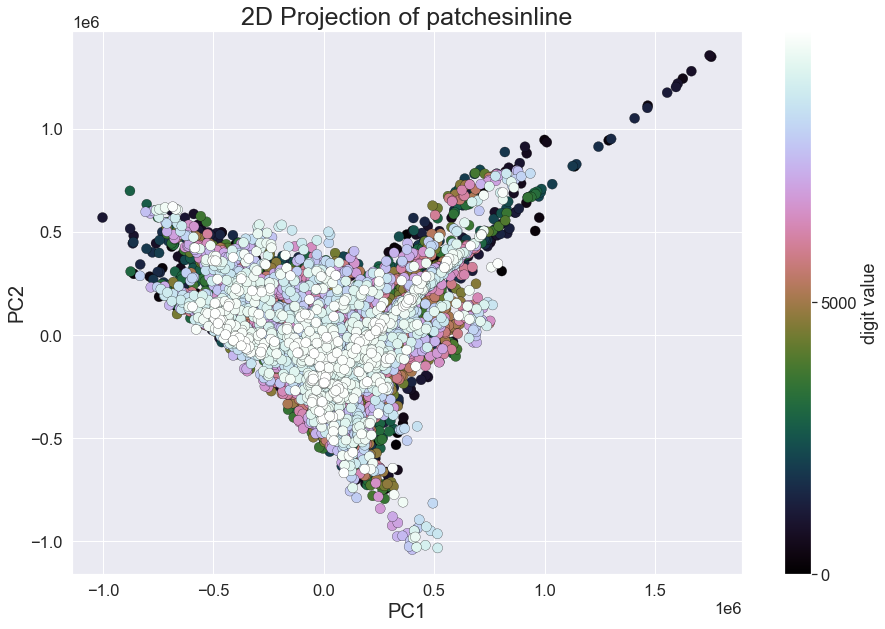

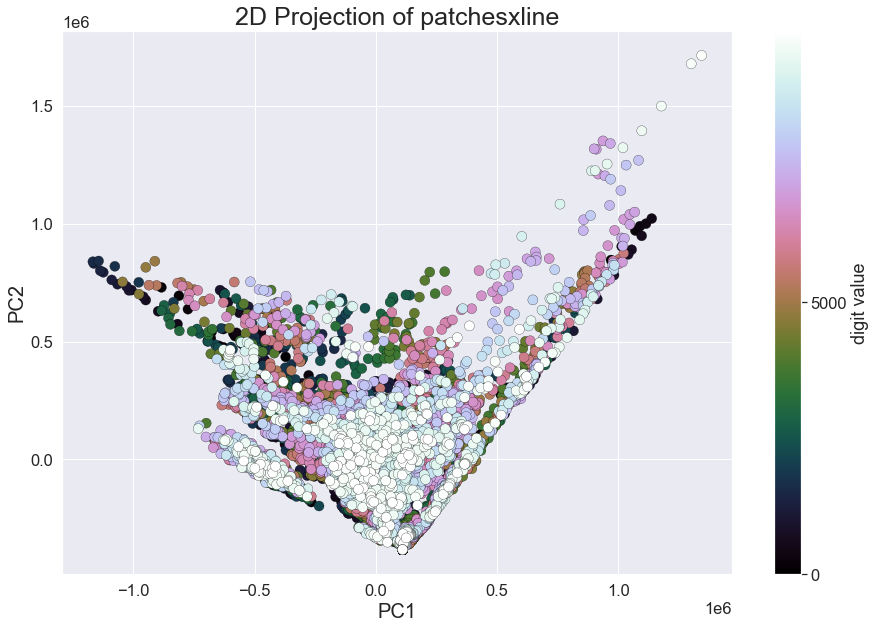

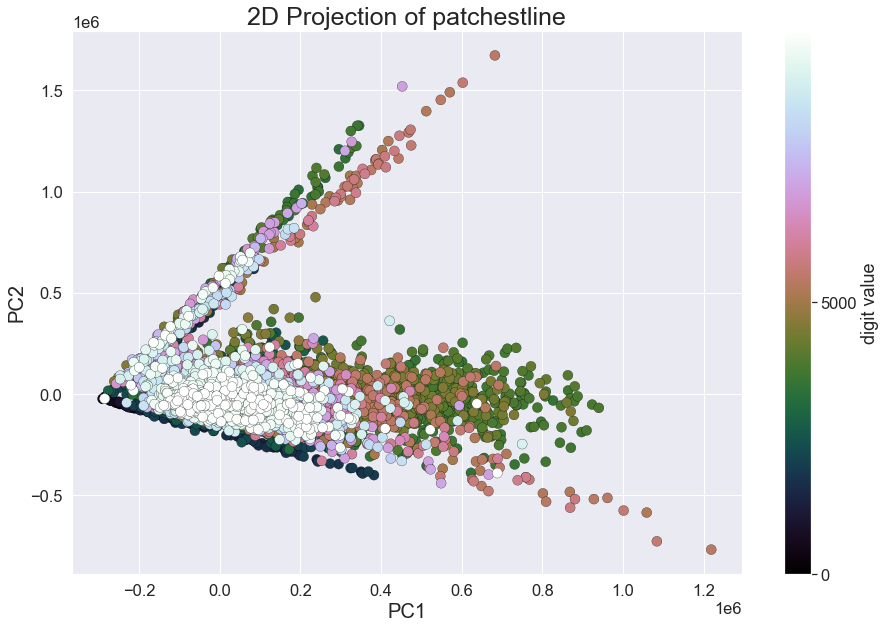

In [26]:
### plot pca of each direciton
for dir in directions:
    labelss =patched_labels[dir][:num_embeddings]
    num_labelss = int(np.max(labelss))
    print("num_labelsss", num_labelss, labelss[-1])
    filename = output_folder + "/pca_" + dir + ".png"
    scatter(pca[dir], labelss, num_labelss, dir, show_labels=False, output=filename) 

Plottting:  inline
Plottting:  xline
Plottting:  tline


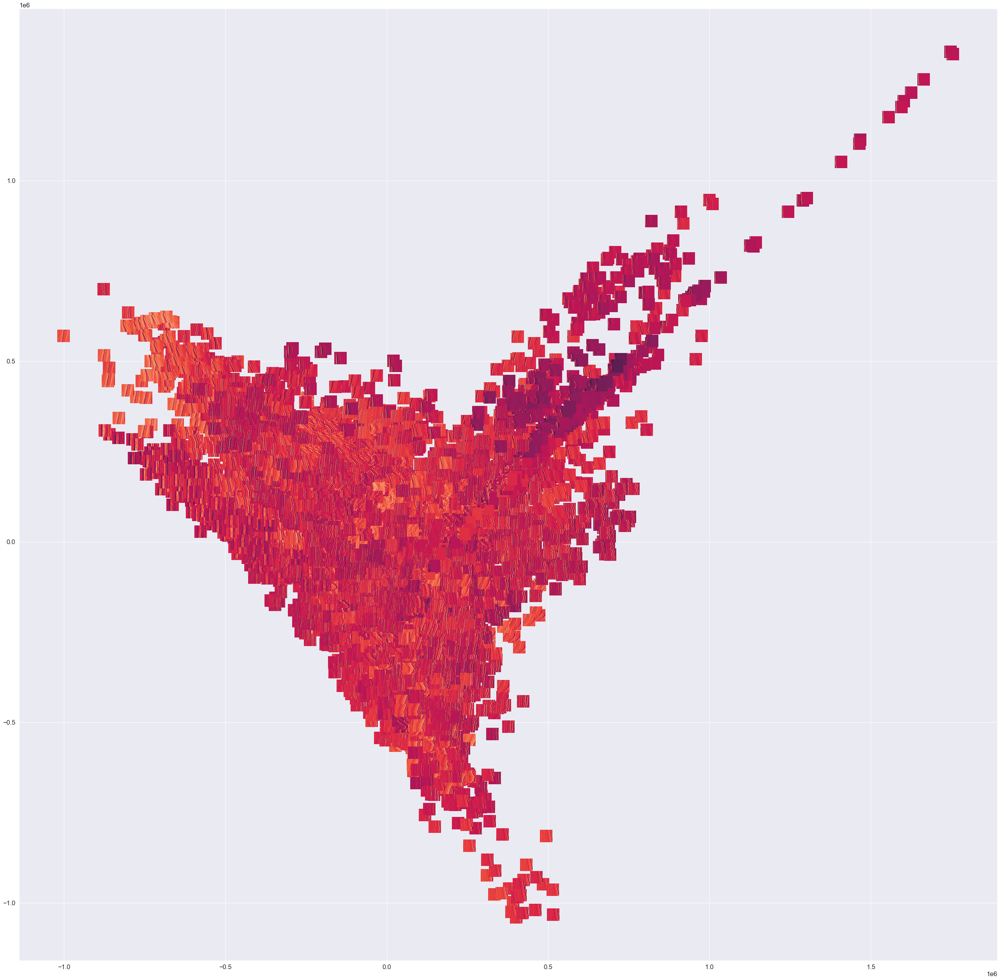

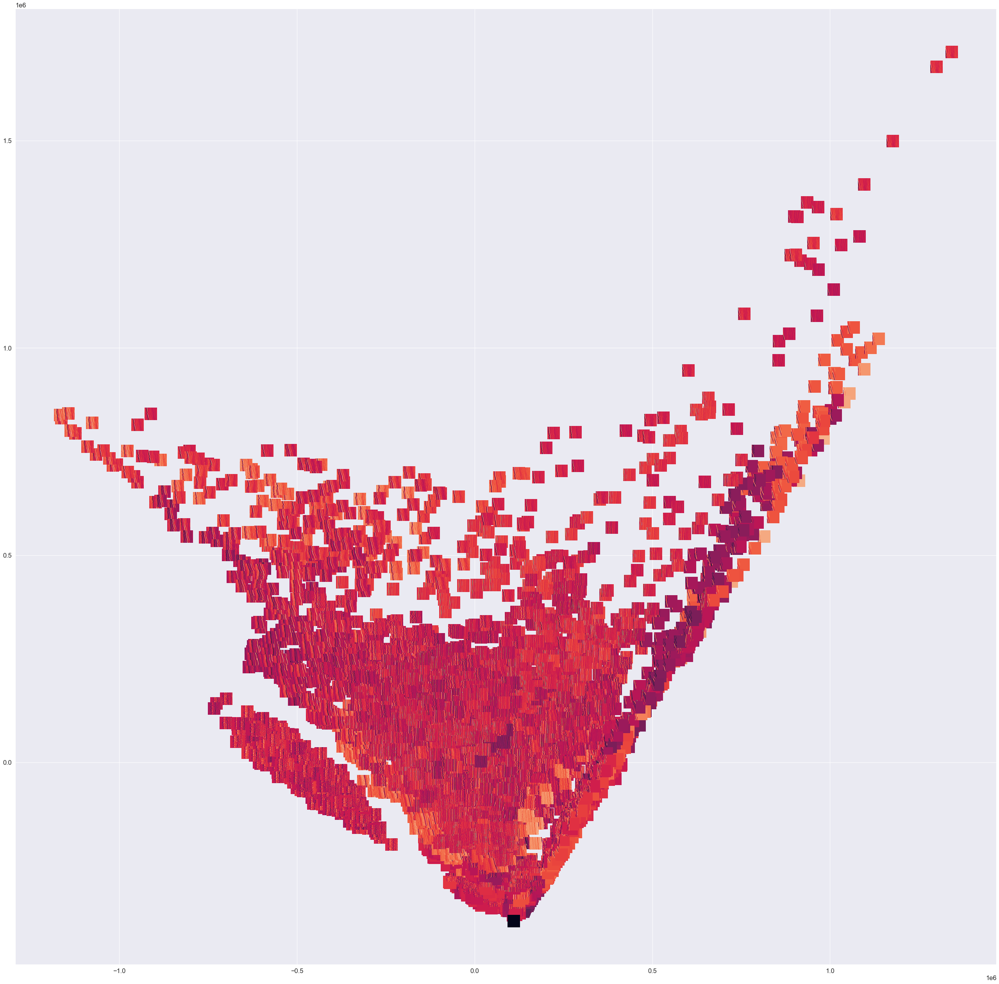

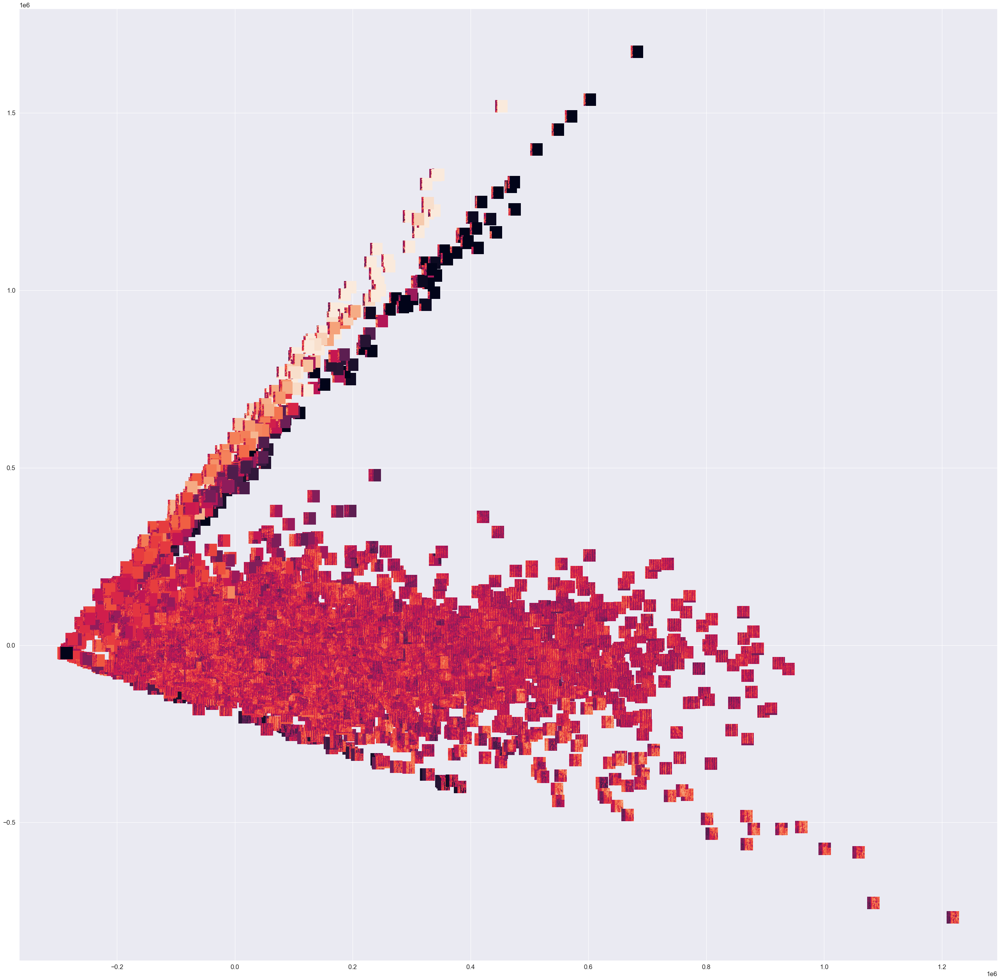

In [27]:
# visualise the scatterplot in actual images 
    
for dir in directions:
    print("Plottting: ", dir)
    images = patched_data[dir]
    plots = pca[dir]
    filename = output_folder + "/pca_sliceplot_" + dir + ".png"
    visualize_scatter_with_images(plots, images = [np.reshape(i, (patch_size, patch_size)).T for i in images], image_zoom=0.5,output=filename)

In [28]:
from sklearn.metrics.pairwise import pairwise_distances
from sklearn.manifold import TSNE
from sklearn.manifold.t_sne import (_joint_probabilities,
                                    _kl_divergence)
# Random state we define this random state to use this value in TSNE which is a randmized algo.
RS = 25111993
T_SNE ={}
for dir in directions:
    
    filename = output_folder + "/T_SNE_" + dir + ".npy"
    if not os.path.exists(filename):
        print("did not find data.. creating new...")
        T_SNE[dir] = TSNE(random_state=RS).fit_transform(embedded[dir])
        # store the data 
        np.save(filename, T_SNE[dir])
    else:
        print("found data. loading it to memory")
        T_SNE[dir] = np.load(filename)
    print(T_SNE[dir].shape)
    
    

did not find data.. creating new...
(10000, 2)
did not find data.. creating new...
(10000, 2)
did not find data.. creating new...
(10000, 2)


num_labelsss 9999 9999.0
num_labelsss 9999 9999.0
num_labelsss 9999 9999.0


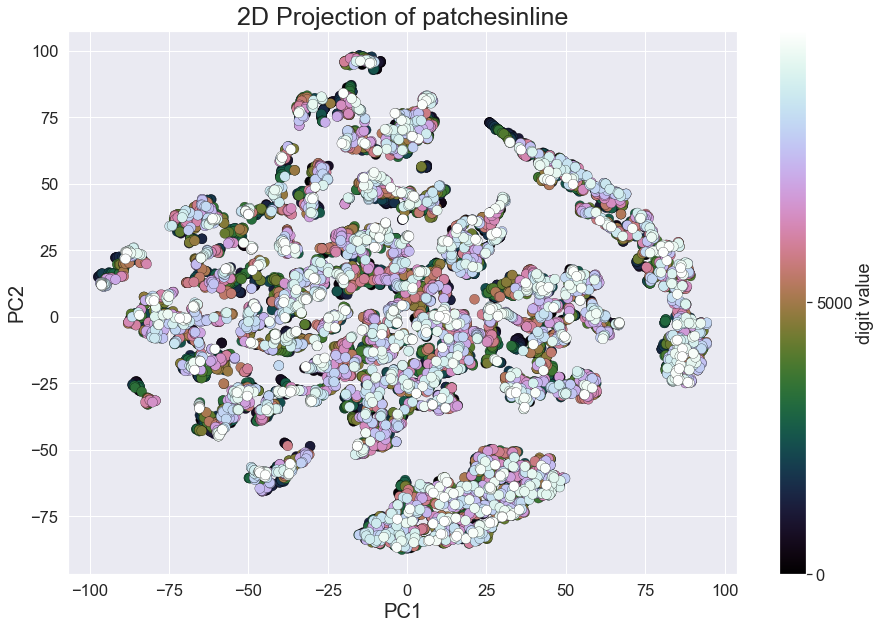

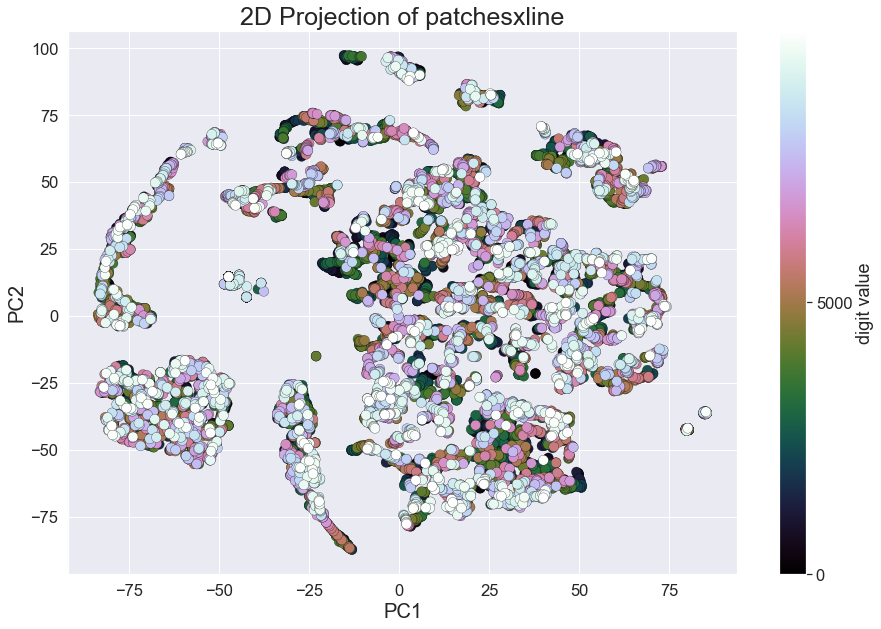

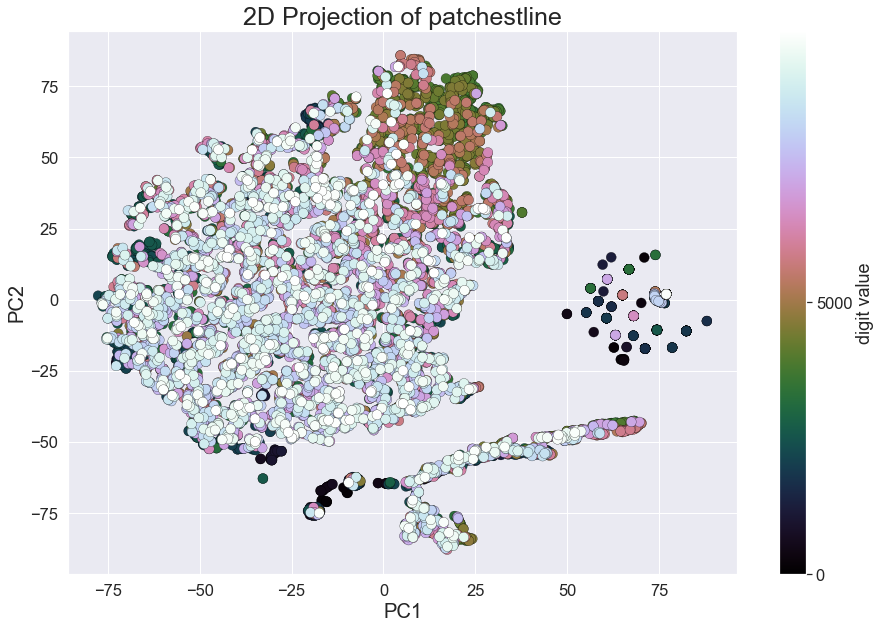

In [29]:
### plot pca of each direciton
for dir in directions:
    labelss =patched_labels[dir][:num_embeddings]
    num_labelss = int(np.max(labelss))
    print("num_labelsss", num_labelss, labelss[-1])
    filename = output_folder + "/T_SNE_" + dir + ".png"
    scatter(T_SNE[dir], labelss, num_labelss, dir, show_labels=False, output=filename)


Plottting:  inline
Plottting:  xline
Plottting:  tline


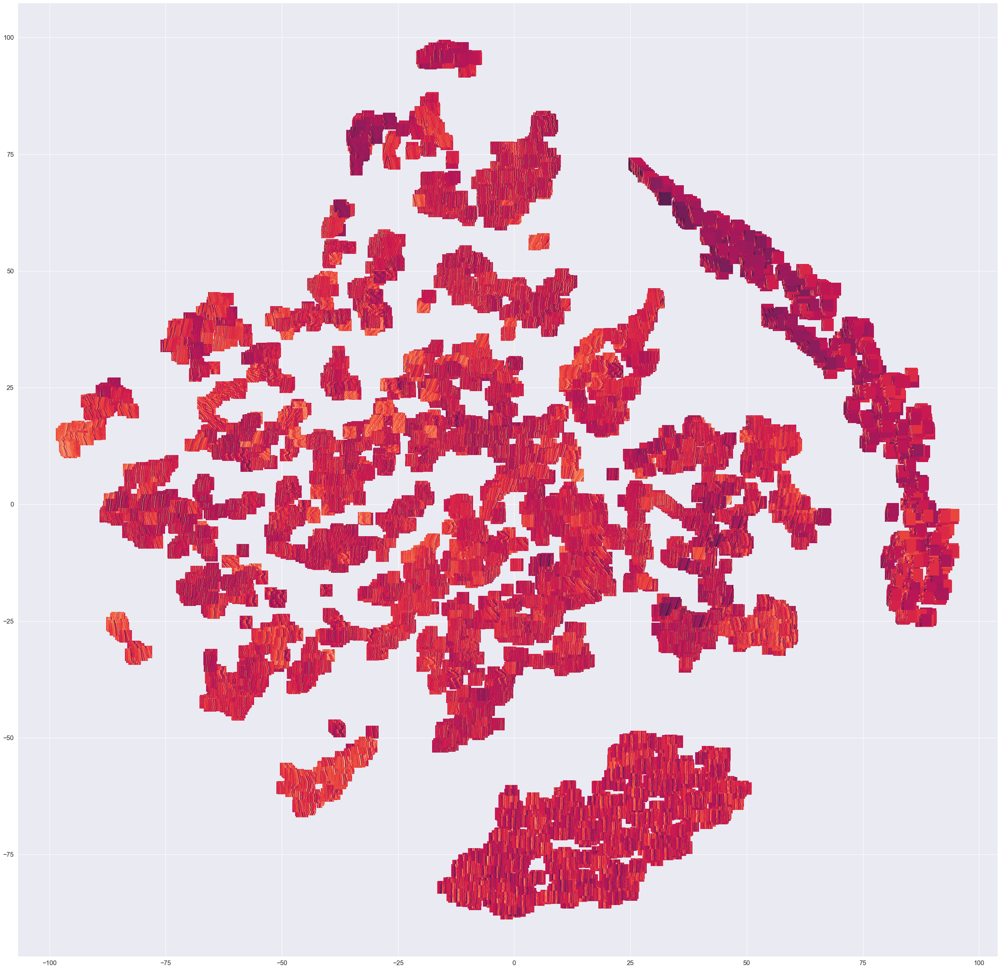

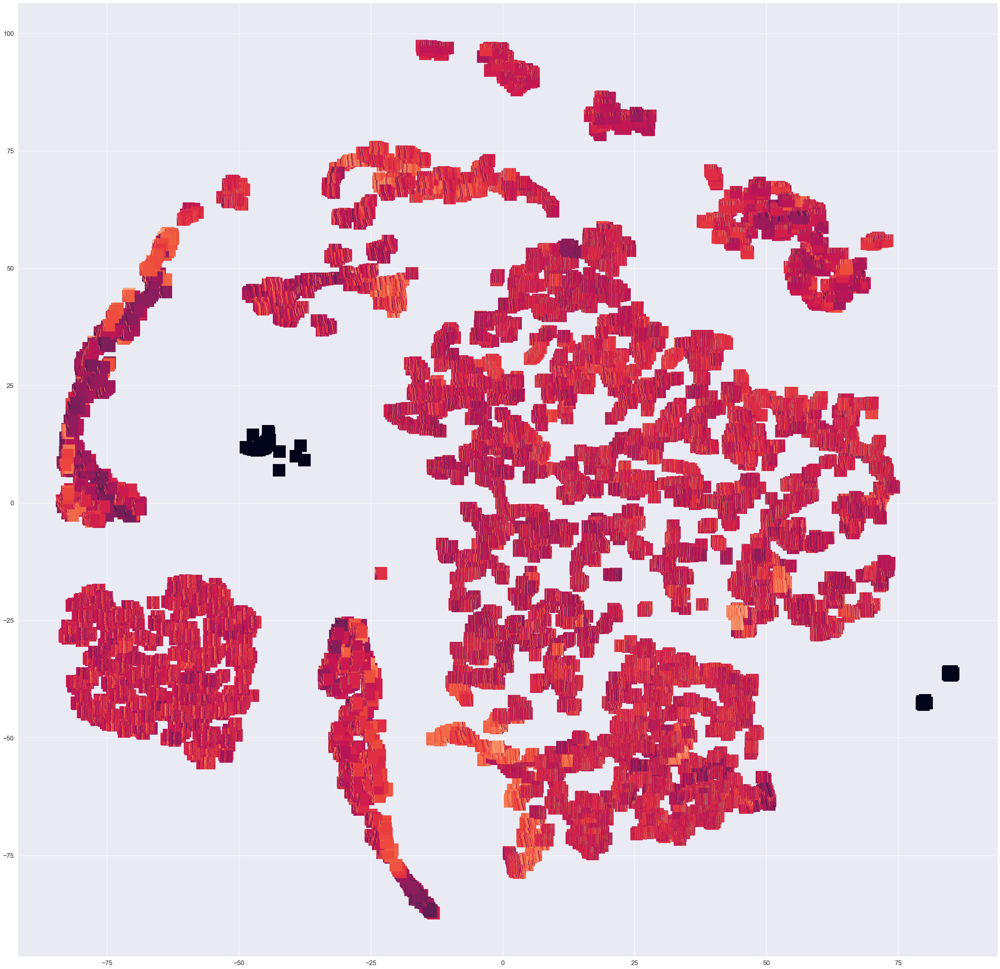

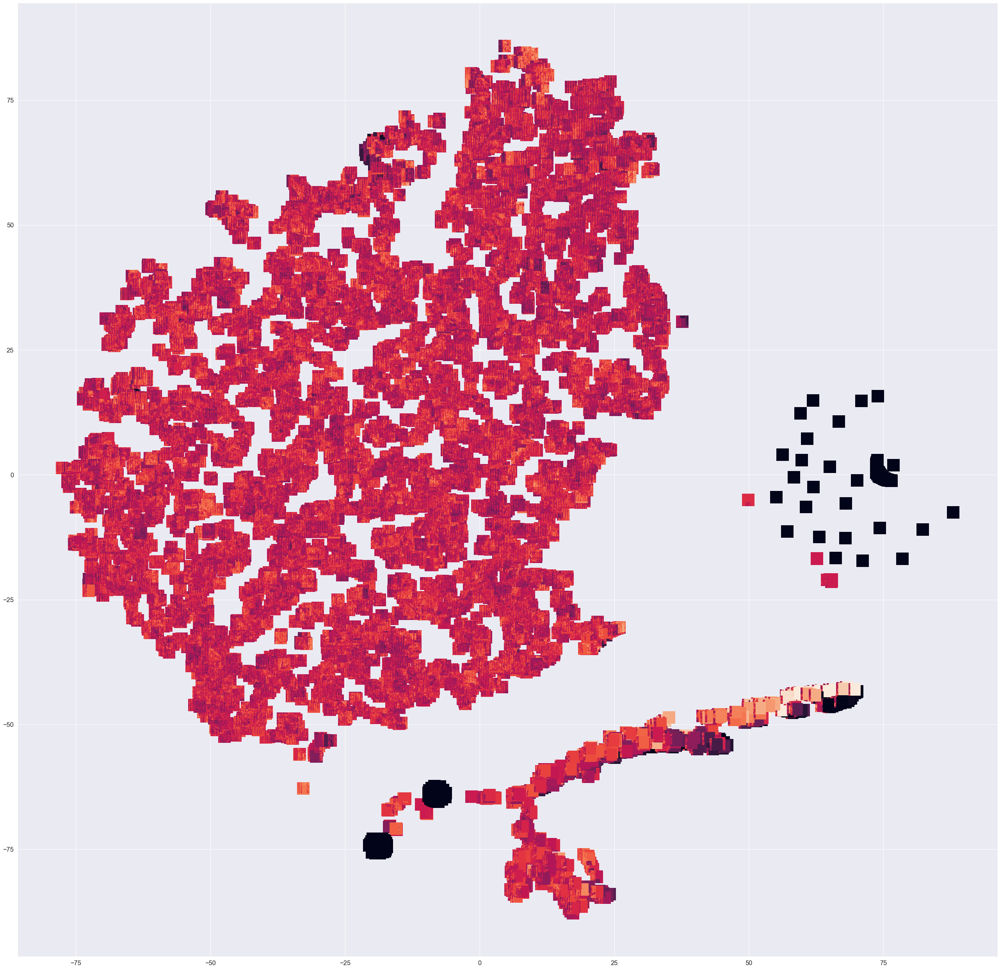

In [30]:
# visualise the scatterplot in actual images 
    
for dir in directions:
    print("Plottting: ", dir)
    images = patched_data[dir]
    plots = T_SNE[dir]
    filename = output_folder + "/T_SNE_sliceplot_" + dir + ".png"
    visualize_scatter_with_images(plots, images = [np.reshape(i, (patch_size, patch_size)).T for i in images], image_zoom=0.5,output=filename)

In [ ]:
## TODO 
# plot contex encoding

#need to add positives AND negative samples!!! (negative = random order) and also add labels of course

# we see from the the papaer that more predictive_temrs gives bettr accuracy. in 3d, we have the possibility to perform such 
# predictive_terms in x dimensions. on is clumnwis in the slice to the top/bottom, one is row wise in the slice to left/right, one i backwards/forward in ortgonal
# as predicting multiple steps is important for learning useful features, smaller patch_size gives us more columns :) 

# compare different strategies for drawing negative samples
    # same column, wrong/random order,
    # other slice/column, right order 
    # other column, wrong/ranodm order
    # other direction, right order
    # other direction, wrong/random order
    # random direction/slcie/column, patch taken from anytwhere, so no predictive term is prom the same column
# replot after augmentation 
# use different patch size

In [ ]:
# so why do we not see a huge difference?
# cpc will use more vclobal features to represent each patch. therefor 